This notebook is intended to solve the demand forecasting challenge using walmart's dataset as part of the technical ealuation 


The goal of this excercise is to project sales for each department in each store

In [1]:
# importing the libraries needed for the study
import numpy as np
import pandas as pd
from pandas_profiling import ProfileReport # it gives more robust exploratory analysis
from sklearn.model_selection import GridSearchCV # exhaustive search over specified parameter values for an estimator
from sklearn.tree import DecisionTreeRegressor # a decision tree regression model
from sklearn.metrics import mean_squared_error, mean_absolute_error
import matplotlib.pyplot as plt # plotting cute graphs
%matplotlib inline


In [2]:
import os
for dirname, _ , filenames in os.walk('C:/Users/PYTHON/Downloads'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

C:/Users/PYTHON/Downloads\-study-notes.txt
C:/Users/PYTHON/Downloads\.Rhistory
C:/Users/PYTHON/Downloads\.zip
C:/Users/PYTHON/Downloads\13686_17112022_090017848XXXX.ocAUBriQ.pdf.part
C:/Users/PYTHON/Downloads\13686_17112022_090017848XXXX.pdf
C:/Users/PYTHON/Downloads\15.-Department-of-Radiography-and-Imaging-Medical-Imaging-Sciences.pdf
C:/Users/PYTHON/Downloads\15809115031169749005.pdf
C:/Users/PYTHON/Downloads\1581582642185017144.pdf
C:/Users/PYTHON/Downloads\2023-Mandela-Washington-Fellowship-Application-Instructions_FINAL(1).pdf
C:/Users/PYTHON/Downloads\2023-Mandela-Washington-Fellowship-Application-Instructions_FINAL(2).pdf
C:/Users/PYTHON/Downloads\2023-Mandela-Washington-Fellowship-Application-Instructions_FINAL.pdf
C:/Users/PYTHON/Downloads\2023-Recruitment-Toolkit_Alumni_FINAL.pdf
C:/Users/PYTHON/Downloads\2023-Recruitment-Toolkit_Partners_FINAL.pdf
C:/Users/PYTHON/Downloads\2023-Recruitment-Toolkit_USG_FINAL.pdf
C:/Users/PYTHON/Downloads\21 TYPES OF SKIRTS - A to Z of Skirts

C:/Users/PYTHON/Downloads\designs\(11) Facebook.html
C:/Users/PYTHON/Downloads\designs\168835761_5339425472797831_1437863319017510783_n.jpg
C:/Users/PYTHON/Downloads\designs\Figure-Template-40-2.webp
C:/Users/PYTHON/Downloads\designs\Figure-Template-42-1.webp
C:/Users/PYTHON/Downloads\designs\(11) Facebook_files\-fOfcMVSzXY.js.download
C:/Users/PYTHON/Downloads\designs\(11) Facebook_files\-FRoXaHLXgZ.png
C:/Users/PYTHON/Downloads\designs\(11) Facebook_files\-ukBInyztEL.js.download
C:/Users/PYTHON/Downloads\designs\(11) Facebook_files\-w-hfIymINF.js.download
C:/Users/PYTHON/Downloads\designs\(11) Facebook_files\-XwL_XTzOvmikSkks2vO1bSG0w05a4FBHCRRFpStDt_Xi6qkW_c2g9RoBbBsL67mzHXgLVX4rpq4-Gsk883k9_xjLyqQ_ZJxLG_wbkP-eUpV8OkJIl8ySeMlnryoiryPUGwDtwZ_BmTdIJQP5GplPZabScG45pWnT5lS4MyU5PpFWY2yghc6dBWU4DFS3TLOqYqN.download
C:/Users/PYTHON/Downloads\designs\(11) Facebook_files\0OyffOvPj0E.js.download
C:/Users/PYTHON/Downloads\designs\(11) Facebook_files\0_4VMYJI3an.js.download
C:/Users/PYTHON/Down

C:/Users/PYTHON/Downloads\Hello, Python Kaggle_files\1.js
C:/Users/PYTHON/Downloads\Hello, Python Kaggle_files\107678-gr.jpg
C:/Users/PYTHON/Downloads\Hello, Python Kaggle_files\124542-kg.jpg
C:/Users/PYTHON/Downloads\Hello, Python Kaggle_files\135919-kg.jpg
C:/Users/PYTHON/Downloads\Hello, Python Kaggle_files\139360-fb.jpg
C:/Users/PYTHON/Downloads\Hello, Python Kaggle_files\15.js
C:/Users/PYTHON/Downloads\Hello, Python Kaggle_files\23640-gr.jpg
C:/Users/PYTHON/Downloads\Hello, Python Kaggle_files\2783499-kg.jpg
C:/Users/PYTHON/Downloads\Hello, Python Kaggle_files\28695-kg.jpg
C:/Users/PYTHON/Downloads\Hello, Python Kaggle_files\3.js
C:/Users/PYTHON/Downloads\Hello, Python Kaggle_files\3293-kg.jpg
C:/Users/PYTHON/Downloads\Hello, Python Kaggle_files\4.js
C:/Users/PYTHON/Downloads\Hello, Python Kaggle_files\473824-kg.jpg
C:/Users/PYTHON/Downloads\Hello, Python Kaggle_files\analytics.js
C:/Users/PYTHON/Downloads\Hello, Python Kaggle_files\api.js
C:/Users/PYTHON/Downloads\Hello, Python K

C:/Users/PYTHON/Downloads\train.csv\train.csv
C:/Users/PYTHON/Downloads\Video\Carl Storm - With You In The Morning.mp4
C:/Users/PYTHON/Downloads\Video\DataFrame Data Structure - Coursera.webm
C:/Users/PYTHON/Downloads\Video\DataFrame Indexing and Loading - Coursera.webm
C:/Users/PYTHON/Downloads\Video\Date_Time Functionality - Coursera.webm
C:/Users/PYTHON/Downloads\Video\Example- Manipulating DataFrame - Coursera.webm
C:/Users/PYTHON/Downloads\Video\Group by - Coursera.webm
C:/Users/PYTHON/Downloads\Video\Indexing Dataframes - Coursera.webm
C:/Users/PYTHON/Downloads\Video\Introduction to Pandas - Coursera.webm
C:/Users/PYTHON/Downloads\Video\Manipulating Text with Regular Expression - Coursera.webm
C:/Users/PYTHON/Downloads\Video\Maren Morris - To Hell & Back (Lyric Video).mp4
C:/Users/PYTHON/Downloads\Video\Merging Dataframes - Coursera.webm
C:/Users/PYTHON/Downloads\Video\Missing Values - Coursera.webm
C:/Users/PYTHON/Downloads\Video\Numerical Python Library (NumPy) - Coursera.webm


In [3]:
# reading files
train = pd.read_csv('C:/Users/PYTHON/Downloads/train.csv(3).zip')
test = pd.read_csv('C:/Users/PYTHON/Downloads/test.csv(1).zip')
store = pd.read_csv('C:/Users/PYTHON/Downloads/stores.csv')
feature = pd.read_csv('C:/Users/PYTHON/Downloads/features.csv.zip')
sample_submission = pd.read_csv('C:/Users/PYTHON/Downloads/sampleSubmission.csv.zip')

In [4]:
train.head()

,Store,Dept,Date,Weekly_Sales,IsHoliday
0,1,1,2010-02-05,24924.50,False
1,1,1,2010-02-12,46039.49,True
2,1,1,2010-02-19,41595.55,False
3,1,1,2010-02-26,19403.54,False
4,1,1,2010-03-05,21827.90,False


In [5]:
feature.head()

,Store,Date,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,IsHoliday
0,1,2010-02-05,42.31,2.572,NaN,NaN,NaN,NaN,NaN,211.096358,8.106,False
1,1,2010-02-12,38.51,2.548,NaN,NaN,NaN,NaN,NaN,211.242170,8.106,True
2,1,2010-02-19,39.93,2.514,NaN,NaN,NaN,NaN,NaN,211.289143,8.106,False
3,1,2010-02-26,46.63,2.561,NaN,NaN,NaN,NaN,NaN,211.319643,8.106,False
4,1,2010-03-05,46.50,2.625,NaN,NaN,NaN,NaN,NaN,211.350143,8.106,False


In [6]:
store.head()

,Store,Type,Size
0,1,A,151315
1,2,A,202307
2,3,B,37392
3,4,A,205863
4,5,B,34875


In [7]:
# let us merge the train, store and feature 
df_aux = train.merge(store, how='left', on='Store')
df_train = df_aux.merge(feature, how='left', on=('Store', 'Date', 'IsHoliday'))
df_train.head()

,Store,Dept,Date,Weekly_Sales,IsHoliday,Type,Size,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment
0,1,1,2010-02-05,24924.50,False,A,151315,42.31,2.572,NaN,NaN,NaN,NaN,NaN,211.096358,8.106
1,1,1,2010-02-12,46039.49,True,A,151315,38.51,2.548,NaN,NaN,NaN,NaN,NaN,211.242170,8.106
2,1,1,2010-02-19,41595.55,False,A,151315,39.93,2.514,NaN,NaN,NaN,NaN,NaN,211.289143,8.106
3,1,1,2010-02-26,19403.54,False,A,151315,46.63,2.561,NaN,NaN,NaN,NaN,NaN,211.319643,8.106
4,1,1,2010-03-05,21827.90,False,A,151315,46.50,2.625,NaN,NaN,NaN,NaN,NaN,211.350143,8.106


In [8]:
# use pandas profiling to analyse the dataset
df_train.profileReport()

AttributeError: 'DataFrame' object has no attribute 'profileReport'

In [8]:
df_train.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [9]:
# creating year, month, week and day columns
df_train['Date'] = pd.to_datetime(df_train['Date'])
df_train['Year'] = (df_train.Date.dt.year).astype(int)
df_train['Month'] = (df_train.Date.dt.month).astype(int)
df_train['Week'] = ((df_train.Date.dt.isocalendar().week)*1.0).astype(int)
df_train['Day'] = (df_train.Date.dt.day).astype(int)

In [10]:
# replacing the False and True values of the IsHoliday column with 0 and 1
df_train['IsHoliday'].replace({False: 0, True: 1}, inplace=True)

In [11]:
#adding columns for Holidays
df_train['SuperBowl'] = df_train['Week'].apply(lambda x: 1 if x == 6 else 0)
df_train['LaborDay'] = df_train['Week'].apply(lambda x: 1 if x == 35 else 0)
df_train['Thanksgiving'] = df_train['Week'].apply(lambda x: 1 if x == 46 else 0)
df_train['Christmas'] = df_train['Week'].apply(lambda x: 1 if x == 50 else 0)
df_train['Tksgiving_to_Xmas'] = df_train['Week'].apply(lambda x: 1 if (x>46) & (x<52) else 0)

In [12]:
# columns with predictor variables
# Markdown columns are mostly missing values, so we'll try to go without them initially.
predictors = ['IsHoliday', 'Month', 'Day', 'Temperature', 'Fuel_Price', 'CPI', 'Unemployment', 'SuperBowl', 'LaborDay', 'Thanksgiving', 'Christmas', 'Tksgiving_to_Xmas']


In [13]:
# X_train = predictor variables
# Y_train = dependent Variable
X_train = df_train[predictors]
Y_train = df_train.Weekly_Sales

In [14]:
# This function runs GridSearch on the model to test all parameter options
def model(model, params, X, Y, cv = None):
    mod = model
    mod_grid = GridSearchCV(mod, params, cv = cv)
    mod_grid.fit(X, Y)
    
    return mod_grid, mod_grid.best_params_
    

Decision Tree

Decision Tree is one of the most commonly used, practical approaches for supervised learning. It can be used to solve both Regression and Classification.

It is a tree-structured classifier with three types of nodes. The Root Node is the initial node which represents the entire sample and may get split further nodes. The Interior Nodes represent the features of a data set and the branches represent the decision rules.Finally, the Leaf Nodes represent the outcome. This algorithm is very useful for solving decision-related problems.

Why Decision Tree Regression?

Decision trees are used to fit a sine curve with the addition of noisy observaton. As a result, it learns local linear regressions by approximating the sine curve.

We can see that if the maximum tree depth(controlled by the max_depth parameter) is set too high, decision trees learn very fine details from the training data and learn from noise, i.e they overfit.

In [15]:
# decision tree parameters
parameters = {'max_depth': [50,75,100,125],
                 'min_samples_split': [50,75,100,125],
                 'max_features': [0.5,0.75]}

# model DecisionTreeRegressor
model, best_params = model(DecisionTreeRegressor(), parameters, X_train, Y_train, 10)
best_params # best parameters

{'max_depth': 100, 'max_features': 0.5, 'min_samples_split': 125}

In [16]:
# predict_sales column receives predicted weekly sales values
df_train["predict_sales"] = model.predict(df_train[predictors])

In [17]:
# auxiliary dataframes for comparing predicted values with real values
predicted_sales = df_train.groupby('Date')['predict_sales'].sum()
Weekly_Sales = df_train.groupby('Date')['Weekly_Sales'].sum()

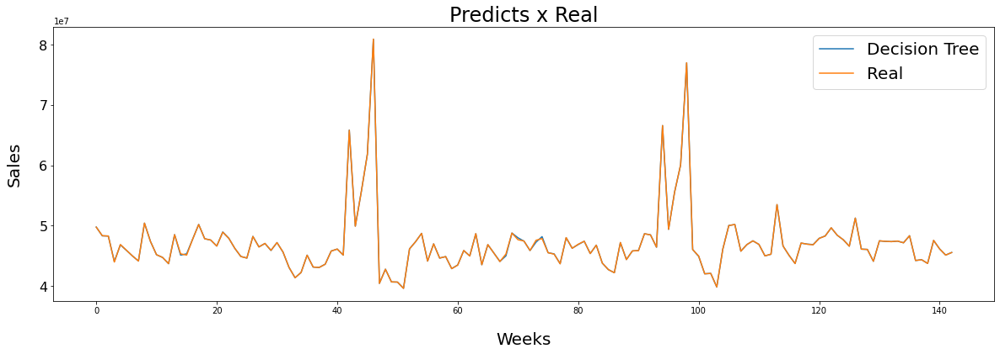

In [18]:
# plotting the comparison chart
plt.figure(figsize=(20,6))
plt.plot(predicted_sales.values)
plt.plot(Weekly_Sales.values)

plt.yticks( fontsize=16)
plt.ylabel('Sales', fontsize=20, labelpad=20)
plt.xlabel('Weeks', fontsize=20, labelpad=20)

plt.title("Predicts x Real", fontsize=24)
plt.legend(['Decision Tree', 'Real'], fontsize=20);

Model Accuracy

The MAE and RMSE metrics are the most used to measure the accuracy of predictive models that aim to predict continous variables.

RSME(root mean squared error): is the measure that calculates "the root mean square" of errors between observed(actual) values and predictions(hypothesis).

MAE(mean absolute error): calculates the "mean absolute error" of errors between observed(actual) values and predictions

Similarities
1. Both measures express the mean error of the predictive model, in relation to the original data(training and/or test)

2. They are in the 0-infinity range and return the magnitude of errors and not their direction.

3. The smaller, the better in both cases.

In [19]:
# this function calculates the quality metrics mae, rmse and wmae
def ml_error(df,y,pred,var_feriado):
    
    
    mae = mean_absolute_error(y, pred)
    rmse = np.sqrt(mean_squared_error(y, pred))
    
    weights = df[var_feriado].apply(lambda x: 1 if x==1 else 5)
    wmae = np.round(np.sum(weights*abs(y-pred))/(np.sum(weights)), 2)
    
    return pd.DataFrame({'MAE' : mae,
                        'RMSE' : rmse,
                        'WMAE' : wmae}, index = [0])
    
    

In [20]:
results = ml_error(X_train, Y_train, df_train["predict_sales"], "IsHoliday")
results

,MAE,RMSE,WMAE
0,14304.295281,21711.09221,14238.99


Adjusting test.csv to apply the model


In [21]:
test.head()

,Store,Dept,Date,IsHoliday
0,1,1,2012-11-02,False
1,1,1,2012-11-09,False
2,1,1,2012-11-16,False
3,1,1,2012-11-23,True
4,1,1,2012-11-30,False


In [22]:
# merge test, store and feature
df_aux_test = test.merge(store, how = 'left', on = 'Store')
df_test = df_aux_test.merge(feature, how = 'left', on = ('Store', 'Date', 'IsHoliday'))
df_test.head()

,Store,Dept,Date,IsHoliday,Type,Size,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment
0,1,1,2012-11-02,False,A,151315,55.32,3.386,6766.44,5147.70,50.82,3639.90,2737.42,223.462779,6.573
1,1,1,2012-11-09,False,A,151315,61.24,3.314,11421.32,3370.89,40.28,4646.79,6154.16,223.481307,6.573
2,1,1,2012-11-16,False,A,151315,52.92,3.252,9696.28,292.10,103.78,1133.15,6612.69,223.512911,6.573
3,1,1,2012-11-23,True,A,151315,56.23,3.211,883.59,4.17,74910.32,209.91,303.32,223.561947,6.573
4,1,1,2012-11-30,False,A,151315,52.34,3.207,2460.03,NaN,3838.35,150.57,6966.34,223.610984,6.573


In [23]:
# using pandas profiling for analysis of df
df_test.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [24]:
#est creating year, month, week and day columns
df_test['Date'] = pd.to_datetime(df_test['Date'])
df_test['Year'] = (df_test.Date.dt.year).astype(int)
df_test['Month'] = (df_test.Date.dt.month).astype(int)
df_test['Week'] = ((df_test.Date.dt.isocalendar().week)*1.0).astype(int)
df_test['Day'] = (df_test.Date.dt.day).astype(int)

In [30]:
# adding columns for holidays
df_test['SuperBowl'] = df_test['Week'].apply(lambda x: 1 if x == 6 else 0)
df_test['LaborDay'] = df_test['Week'].apply(lambda x: 1 if x == 35 else 0)
df_test['Thanksgiving'] = df_test['Week'].apply(lambda x: 1 if x == 46 else 0)
df_test['Christmas'] = df_test['Week'].apply(lambda x: 1 if x == 51 else 0)
df_test["Tksgiving_to_Xmas"] = df_test['Week'].apply(lambda x: 1 if (x>46) & (x<52) else 0)
df_test.head()

,Store,Dept,Date,IsHoliday,Type,Size,Temperature,Fuel_Price,CPI,Unemployment,Year,Month,Week,Day,SuperBowl,LaborDay,Thanksgiving,Tksgiving_to_Xmas,Christmas
0,1,1,2012-11-02,False,A,151315,55.32,3.386,223.462779,6.573,2012,11,44,2,0,0,0,0,0
1,1,1,2012-11-09,False,A,151315,61.24,3.314,223.481307,6.573,2012,11,45,9,0,0,0,0,0
2,1,1,2012-11-16,False,A,151315,52.92,3.252,223.512911,6.573,2012,11,46,16,0,0,1,0,0
3,1,1,2012-11-23,True,A,151315,56.23,3.211,223.561947,6.573,2012,11,47,23,0,0,0,1,0
4,1,1,2012-11-30,False,A,151315,52.34,3.207,223.610984,6.573,2012,11,48,30,0,0,0,1,0


In [33]:
df_test.drop(columns=['MarkDown1', 'MarkDown2', 'MarkDown3', 'MarkDown4', 'MarkDown5'], inplace=True)

KeyError: "['MarkDown1' 'MarkDown2' 'MarkDown3' 'MarkDown4' 'MarkDown5'] not found in axis"

In [34]:
df_test.dropna(inplace=True)
df_test["predict_sales"] = model.predict(df_test[predictors])

In [35]:
predicts = df_test["predict_sales"]

id = df_test['Store'].apply(lambda x: str(x)+'_')+df_test['Dept'].apply(lambda x: str(x)+'_')+df_test['Date'].astype(str)

In [36]:
sample_submission = pd.concat([id,predicts],axis=1)
sample_submission

,0,predict_sales
0,1_1_2012-11-02,18090.267083
1,1_1_2012-11-09,21891.513973
2,1_1_2012-11-16,21891.513973
3,1_1_2012-11-23,31440.592778
4,1_1_2012-11-30,30402.858784
...,...,...
115046,45_98_2013-03-29,15372.883611
115047,45_98_2013-04-05,9006.173623
115048,45_98_2013-04-12,9410.605303
115049,45_98_2013-04-19,16164.854444
